## Zillow Listing and Sales Data

In [33]:
import pandas as pd
import numpy as np
import altair as alt

from datetime import datetime

today = datetime.today()

def doChart(metric='Metro_Listings_PriceCut_SeasAdj_AllHomes', location='United States', unit='%', zero=True, yoy=False):
    url = 'https://files.zillowstatic.com/research/public/Metro/{}.csv'.format(metric)

    df_raw = pd.read_csv(url, encoding = "ISO-8859-1")

    months = df_raw.columns.to_list()[3:]

    df_tmp = df_raw.set_index('RegionName')[months].T.reset_index()
    print('Most recent data: {}'.format(months[-1]))
    
    if yoy:
        df_yoy = df_tmp[['index', location]].sort_values('index').copy()
        df_yoy = df_yoy.set_index('index')
        df_yoy['Change'] = df_yoy[location].apply(lambda v: v if isinstance(v, float) else np.nan).pct_change(12).apply(lambda v: 100 * v)
        df_yoy = df_yoy.dropna()
        
        #print(df_yoy.tail(20))
        
        return alt.Chart(df_yoy.reset_index()).mark_bar().encode(
            alt.X('index:T', axis=alt.Axis(title='', format="%b-%y")),
            alt.Y('Change:Q', axis=alt.Axis(title=metric.replace('_', ' ') + " [{}]".format(unit))),
            tooltip=[alt.Tooltip('Change:Q'), alt.Tooltip('index:T', format='%B %Y')]
        ).properties(
            title="Zillow {} ({}) YoY Growth over time".format(metric.replace('_', ' '), location),
            width=750,
            height=450,
            background='white'
        )        
    else:
        return alt.Chart(df_tmp).mark_line().encode(
            alt.X('index:T', axis=alt.Axis(title='', format="%b-%y")),
            alt.Y('{}:Q'.format(location),
                  scale=alt.Scale(zero=zero),
                  axis=alt.Axis(title=metric.replace('_', ' ') + " [{}]".format(unit))),
            tooltip=[alt.Tooltip('{}:Q'.format(location)), alt.Tooltip('index:T', format='%B %Y')]
        ).properties(
            title="Zillow {} ({}) over time".format(metric.replace('_', ' '), location),
            width=750,
            height=450,
            background='white'
        )

Most recent data: 2019-12


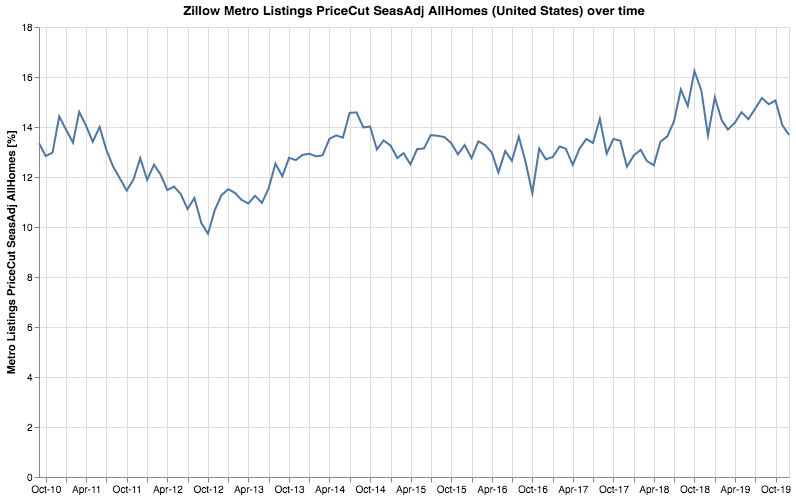

In [20]:
doChart(metric='Metro_Listings_PriceCut_SeasAdj_AllHomes', location='United States')

Most recent data: 2019-12


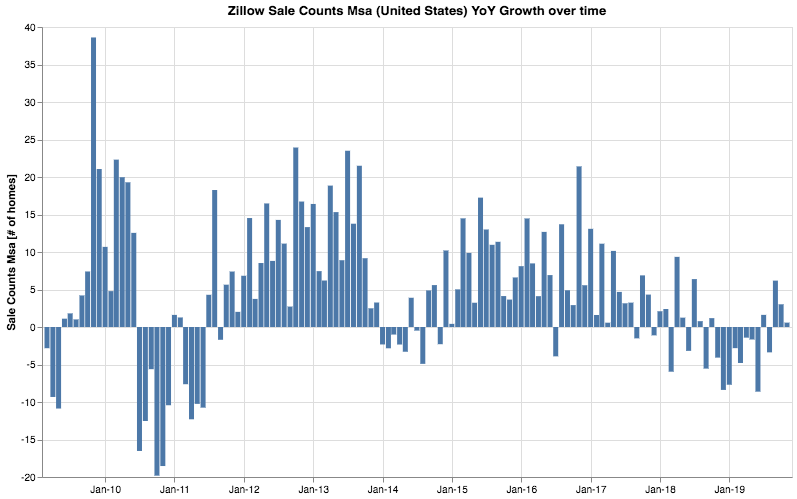

In [26]:
doChart(metric='Sale_Counts_Msa', location='United States', unit='YoY % Growth', yoy=True)

Most recent data: 2019-12


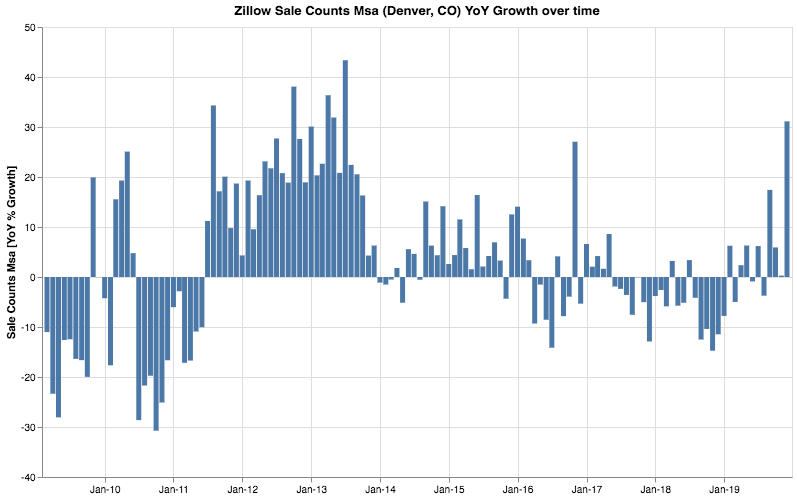

In [27]:
doChart(metric='Sale_Counts_Msa', location='Denver, CO', unit='YoY % Growth', yoy=True)

Most recent data: 2019-12


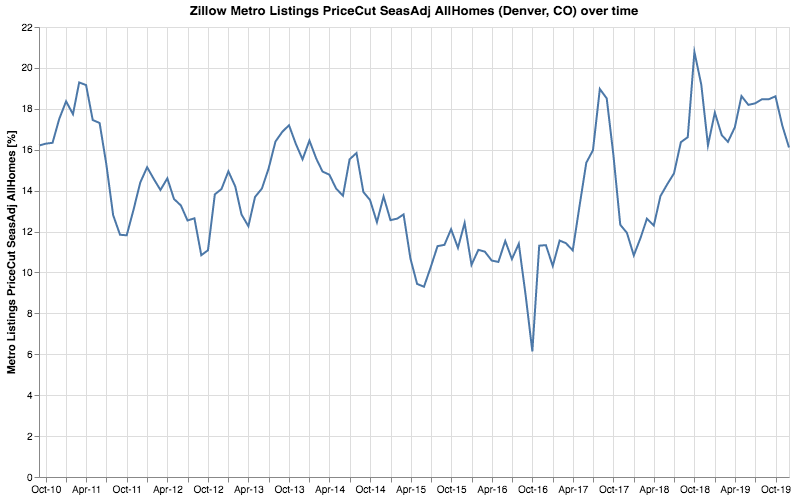

In [3]:
doChart(metric='Metro_Listings_PriceCut_SeasAdj_AllHomes', location='Denver, CO')

Most recent data: 2019-12


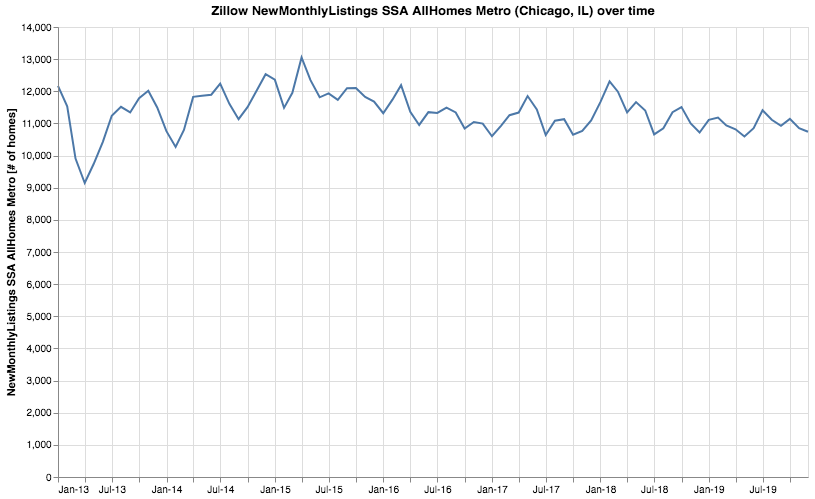

In [4]:
doChart(metric='NewMonthlyListings_SSA_AllHomes_Metro', location='Chicago, IL', unit='# of homes')

Most recent data: 2019-12


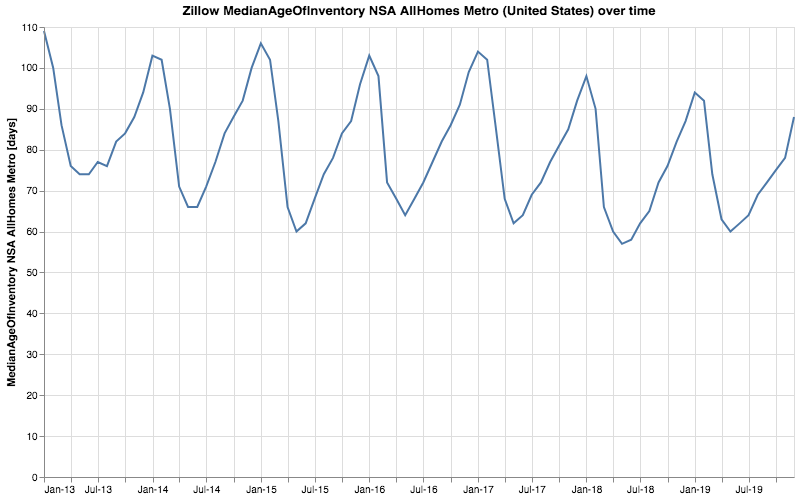

In [5]:
doChart(metric='MedianAgeOfInventory_NSA_AllHomes_Metro', location='United States', unit='days')

Most recent data: 2019-12


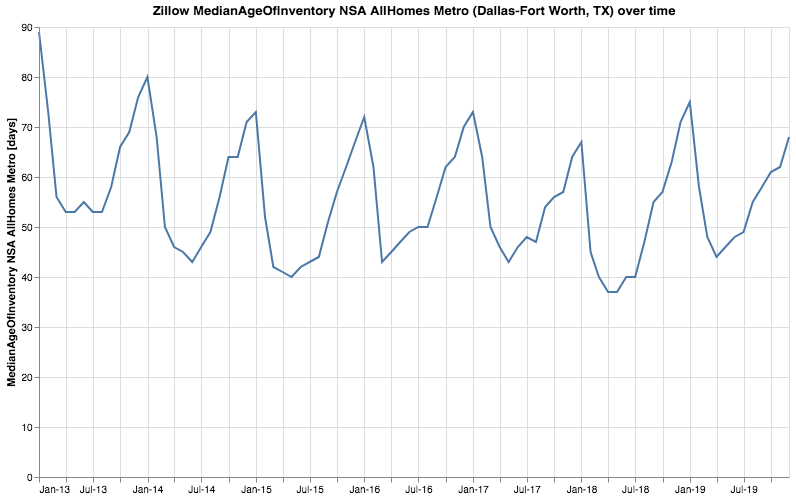

In [6]:
doChart(metric='MedianAgeOfInventory_NSA_AllHomes_Metro', location='Dallas-Fort Worth, TX', unit='days')

Most recent data: 2019-12


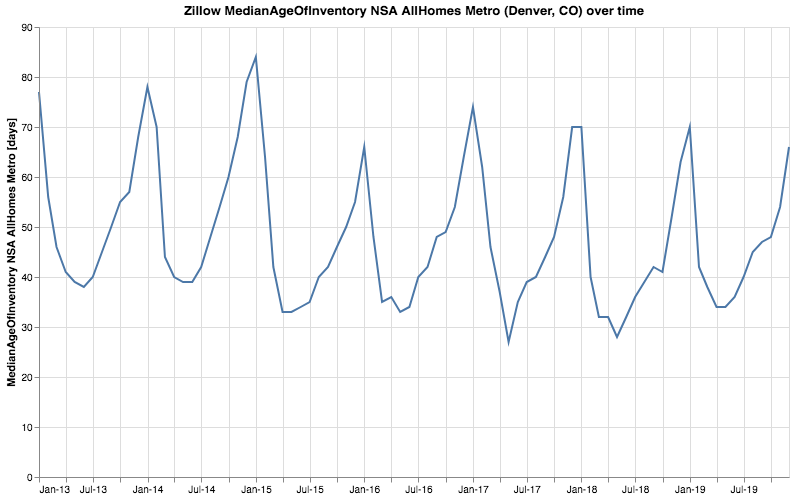

In [7]:
doChart(metric='MedianAgeOfInventory_NSA_AllHomes_Metro', location='Denver, CO', unit='days')

Most recent data: 2019-12


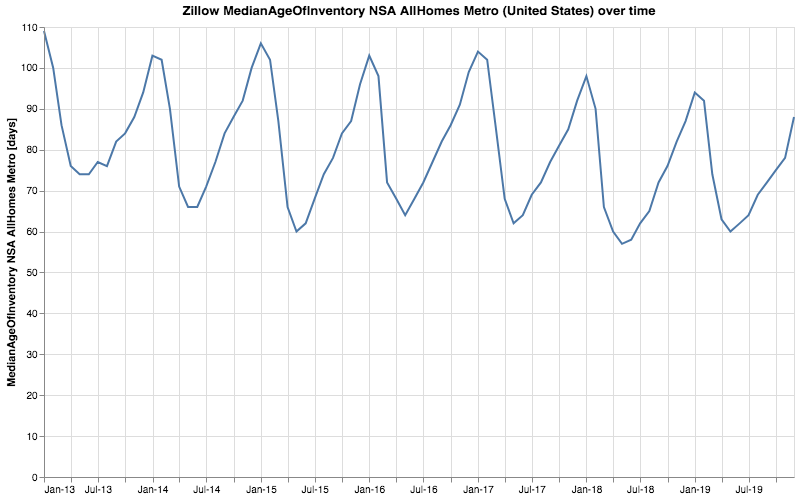

In [8]:
doChart(metric='MedianAgeOfInventory_NSA_AllHomes_Metro', location='United States', unit='days')

Most recent data: 2019-12


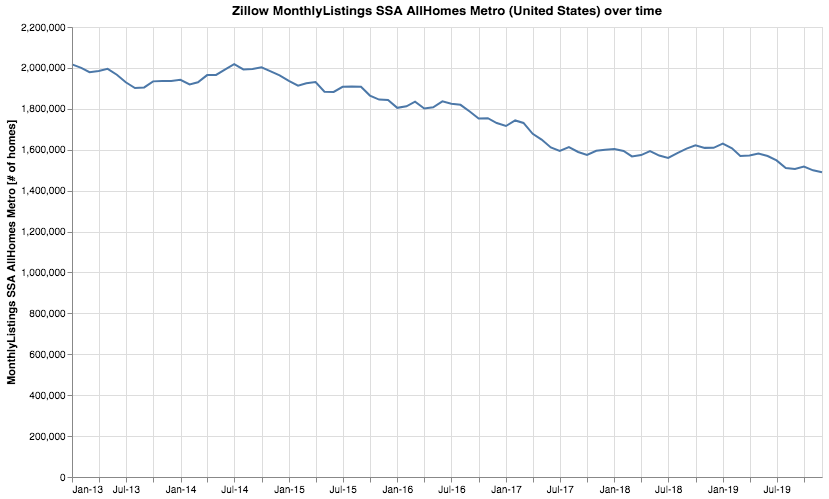

In [9]:
doChart(metric='MonthlyListings_SSA_AllHomes_Metro', location='United States', unit='# of homes')

Most recent data: 2019-12


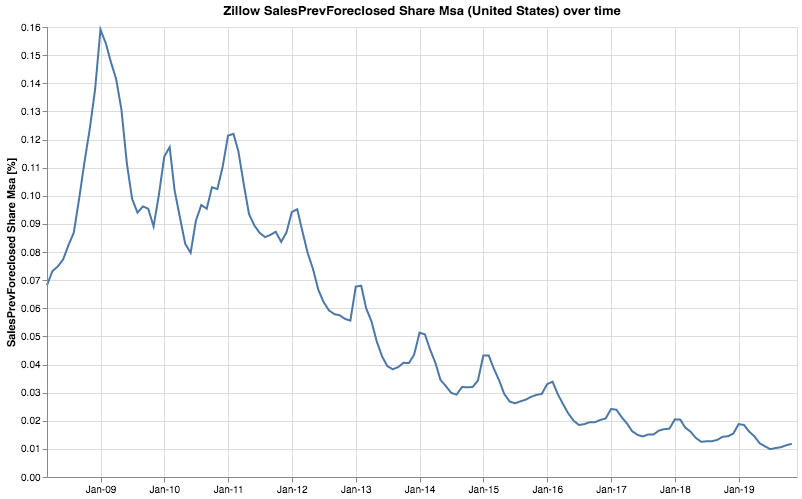

In [10]:
doChart(metric='SalesPrevForeclosed_Share_Msa', location='United States')

Most recent data: 2019-12


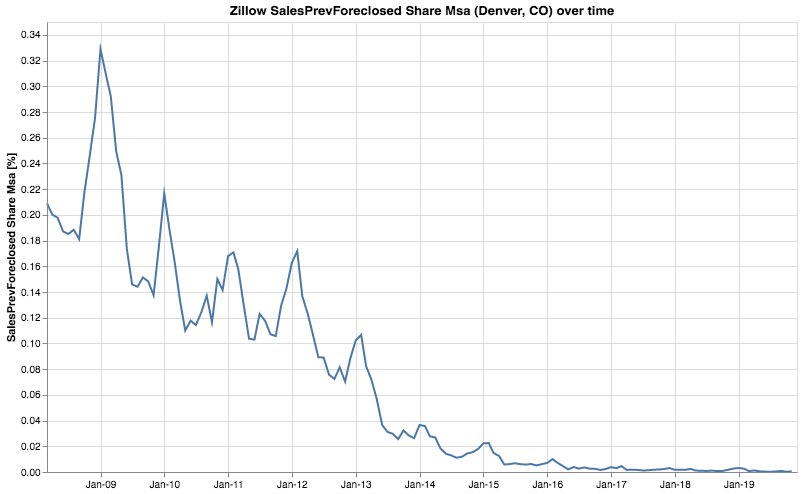

In [11]:
doChart(metric='SalesPrevForeclosed_Share_Msa', location='Denver, CO')

Most recent data: 2019-12


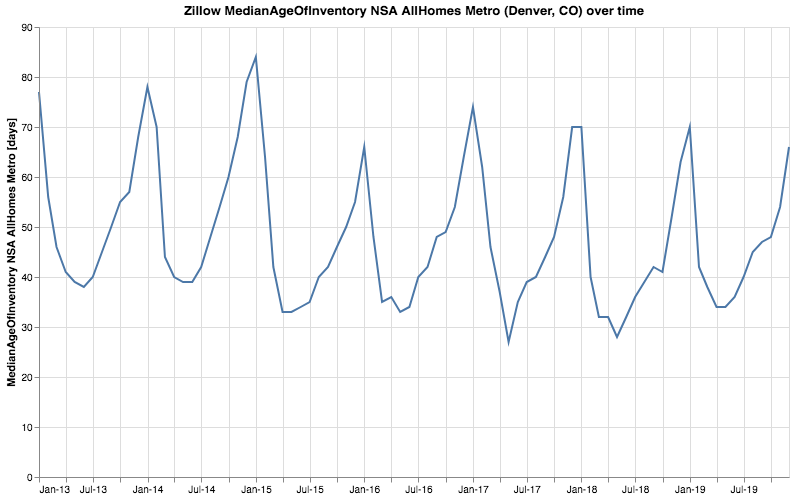

In [12]:
doChart(metric='MedianAgeOfInventory_NSA_AllHomes_Metro', location='Denver, CO', unit='days')

Most recent data: 2019-12


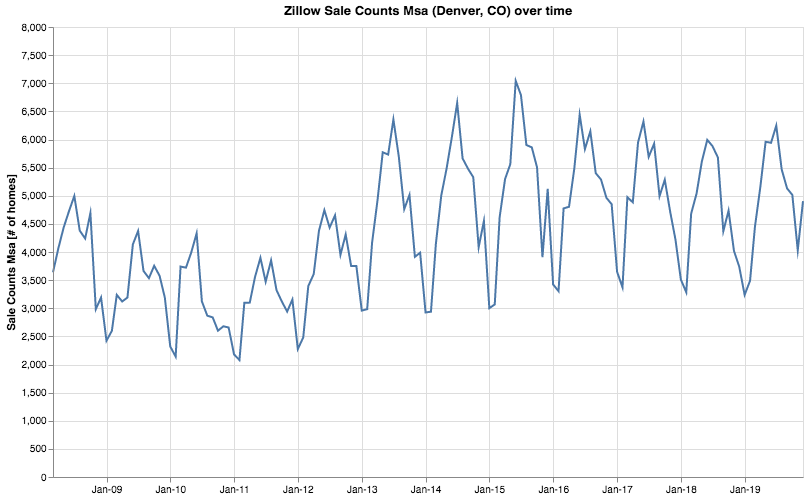

In [13]:
doChart(metric='Sale_Counts_Msa', location='Denver, CO', unit='# of homes')

Most recent data: 2019-06


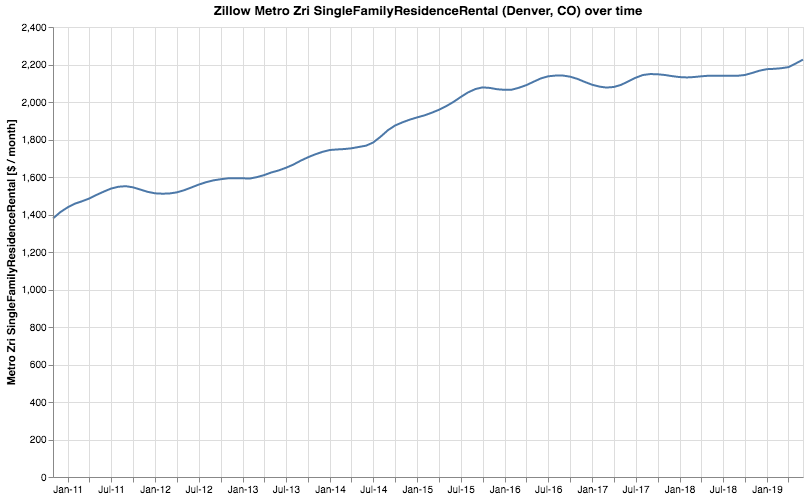

In [14]:
doChart(metric='Metro_Zri_SingleFamilyResidenceRental', location='Denver, CO', unit='$ / month')

Most recent data: 2019-06


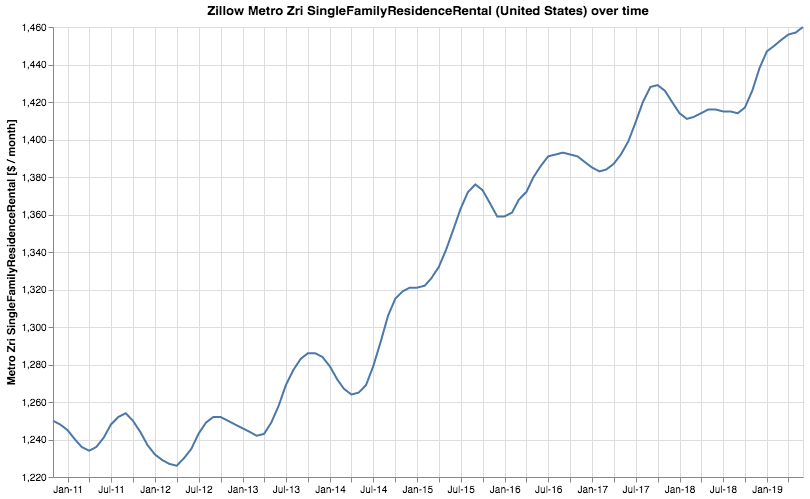

In [15]:
doChart(metric='Metro_Zri_SingleFamilyResidenceRental', location='United States', unit='$ / month', zero=False)